In [1]:
#!pip install pandas_profiling

In [2]:
#please make sure that you have all necessary packages already installed,
#otherwise you can install them by the previous cell with changing the names
import lasio as las
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import pylab 
from pandas_profiling import ProfileReport
import welly
from welly import Well
from welly import Project

In [3]:
df = pd.read_csv('log.csv')
df.head(5)

,Depth,RxoRt,RLL3,SP,RILD,MN,MI,MCAL,DCAL,RHOB,RHOC,DPOR,CNLS,GR
0,195.0,226.0848,0.4076,69.8953,132.5052,-0.3548,0.1863,5.1090,1.8878,1.6973,-0.6303,59.2216,30.0657,60.4576
1,195.5,223.5031,0.4063,69.2303,123.6225,-0.3619,0.1867,5.1031,1.8882,1.6791,-0.6409,60.2877,26.7625,54.1495
2,196.0,221.4560,0.4047,68.4478,116.9258,-0.3668,0.1860,5.0872,1.8878,1.6585,-0.6539,61.4914,27.6017,51.9944
3,196.5,219.8248,0.4033,67.4843,111.7925,-0.3613,0.1867,5.0881,1.8884,1.6435,-0.6649,62.3711,31.5870,52.9645
4,197.0,218.1438,0.4023,66.3013,106.7821,-0.3569,0.1870,5.0972,1.8883,1.6390,-0.6705,62.6343,35.8251,54.9659


In [4]:
df.describe()

,Depth,RxoRt,RLL3,SP,RILD,MN,MI,MCAL,DCAL,RHOB,RHOC,DPOR,CNLS,GR
count,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000,8739.0000000000
mean,2535.7273715528,-18.4935905710,37.9489192242,-94.2997623412,34.5118741961,11.7144420300,12.1806319373,5.9063691498,3.6699442385,2.0336404509,0.1263198192,39.5531995423,20.1292465728,76.9489228516
std,1358.2463024242,31.4209240639,81.7345814710,39.6525582070,251.2383598084,27.5370123125,28.8748615555,1.3055614991,2.7488726541,0.4157099892,0.1039074486,24.3104999497,11.4279089621,33.8594113382
min,195.0000000000,-150.8219000000,0.3899000000,-201.6230000000,0.2104000000,-0.5274000000,-0.6735000000,5.0474000000,1.8853000000,1.1905000000,-0.6705000000,-1.8873000000,-0.5139000000,0.0058000000
25%,1292.2500000000,-31.9939500000,6.4308000000,-131.4211000000,4.3565000000,0.3067000000,0.0976500000,5.0898000000,1.9193500000,1.6890500000,0.0496000000,14.8416000000,8.8882500000,52.3369500000
50%,2623.5000000000,-16.5093000000,12.1384000000,-95.5875000000,7.8229000000,0.9703000000,0.3617000000,5.0985000000,1.9775000000,2.0003000000,0.1098000000,41.5051000000,21.0538000000,77.0340000000
75%,3715.7500000000,-5.9414500000,25.6963000000,-58.0540000000,19.4868000000,7.9781000000,7.3071500000,7.7645500000,7.8500000000,2.4562000000,0.2101000000,59.7036000000,29.5441000000,96.3067000000
max,4808.0000000000,247.5832000000,880.8594000000,69.8953000000,11510.6416000000,252.1242000000,234.8715000000,10.3086000000,12.3349000000,2.7423000000,0.3575000000,88.8601000000,47.5810000000,404.2881000000


In [5]:
#check if data contains NaN values
df.isnull().values.any()

False

In [6]:
print("top=", np.min(df.Depth), "\n", "bottom=", np.max(df.Depth))

top= 195.0 
 bottom= 4808.0


# Generate pandas profiling report - EDA 



In [7]:
report = ProfileReport(df)

In [8]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

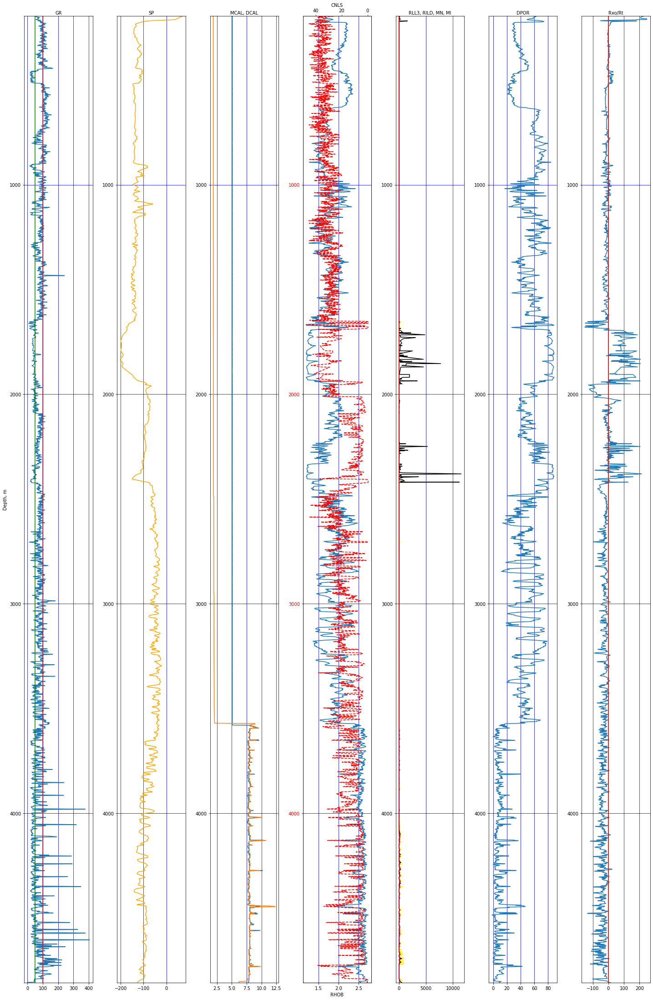

In [9]:
# [['GR', 'SP', 'DPOR', 'RHOC','CNLS','RILD']]

fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(1,7, figsize=(20,30))

#setting Depth limits
plt.setp((ax1, ax2, ax3, ax4, ax5, ax6, ax7), ylim=[np.min(df.Depth), np.max(df.Depth)])
fig.tight_layout()

#*plot Gamma ray log (GR)
ax1.plot(df.GR, df.Depth)
ax1.vlines(100,np.min(df.Depth), np.max(df.Depth), color='red')
ax1.vlines(50,np.min(df.Depth), np.max(df.Depth), color = 'green')

#ax1.fill_betweenx(df.Depth, 80, df.GR, where=df.GR<=40, facecolor = 'black')
#ax1.fill_betweenx(df.Depth, 400, df.GR, where=df.GR>=80, facecolor = 'brown')

ax1.invert_yaxis()
ax1.set_xlabel("GR")
ax1.set_ylabel("Depth, m")
# ax1.set_ylim(4900,180)
ax1.xaxis.set_label_position('top') 
ax1.grid(color='b')

#*plot Spontaneous potential data log (SP)
ax2.plot(df.SP, df.Depth, color='orange')
ax2.invert_yaxis()
ax2.set_xlabel("SP")
ax2.xaxis.set_label_position('top') 
ax2.grid(color='b')

#plot normal caliper (MCAL) and differential caliper (DCAL) log showing size of the well
ax3.plot(df.MCAL, df.Depth)
ax3.plot(df.DCAL, df.Depth)
ax3.invert_yaxis()
ax3.set_xlabel("MCAL, DCAL")
ax3.xaxis.set_label_position('top') 
ax3.grid(color='b')

# #plot bulk density (RHOB) and corrected bulk density (RHOC) data log
# ax4.plot(df.RHOB, df.Depth, color='yellow')
# ax4.plot(df.RHOC, df.Depth, color='red')
# ax4.invert_yaxis()
# ax4.set_xlabel("RHOC, RHOB")
# ax4.xaxis.set_label_position('top') 
# ax4.grid(color='b')

#plot compansated neutron log (CNLS) and bulk density together (RHOB)
ax4.plot(df.RHOB, df.Depth)
ax4.tick_params(axis='y', labelcolor='red')
ax4.invert_yaxis()
ax4.set_xlabel("RHOB")
ax4.grid(color='b')

ax_twin = ax4.twiny()
ax_twin.plot(df.CNLS, df.Depth, color='red', linestyle='dashed')
ax_twin.tick_params(axis='y', labelcolor='green')
ax_twin.set_xlabel('CNLS')
ax_twin.xaxis.set_label_position('top')
ax_twin.invert_xaxis()


# ax4.fill_betweenx(df.RHOB, df.CNLS, 20, facecolor = 'black')

#plot Laterlog 3 (RLL3), deep induction resistivity (RILD), Resistivity wide array (MN), Resistivity intermediate array (MI)
ax5.plot(df.RLL3, df.Depth, color='yellow')
ax5.plot(df.RILD, df.Depth, color='black')
ax5.plot(df.MN, df.Depth, color='blue')
ax5.plot(df.MI, df.Depth, color='red')
ax5.invert_yaxis()
ax5.set_xlabel("RLL3, RILD, MN, MI")
ax5.xaxis.set_label_position('top') 
ax5.grid(color='b')

#plot density porosity log (DPOR)
ax6.plot(df.DPOR, df.Depth)
ax6.invert_yaxis()
ax6.set_xlabel("DPOR")
ax6.xaxis.set_label_position('top') 
ax6.grid(color='b')

#plot Ratio of Shallow and deep resistivity log data (Rxo/Rt)
ax7.plot(df.RxoRt, df.Depth)
ax7.vlines(0,np.min(df.Depth), np.max(df.Depth), color = 'red')
ax7.invert_yaxis()
ax7.set_xlabel("Rxo/Rt")
ax7.xaxis.set_label_position('top')
ax7.grid(color='b')

### Data visualization with Welly package

In [10]:
well = Well.from_df(df)
well.data

{'Depth': Curve(mnemonic=Depth, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'RxoRt': Curve(mnemonic=RxoRt, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'RLL3': Curve(mnemonic=RLL3, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'SP': Curve(mnemonic=SP, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'RILD': Curve(mnemonic=RILD, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'MN': Curve(mnemonic=MN, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'MI': Curve(mnemonic=MI, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'MCAL': Curve(mnemonic=MCAL, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'DCAL': Curve(mnemonic=DCAL, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'RHOB': Curve(mnemonic=RHOB, units=None, start=0.0000, stop=8738.0000, step=1.0000, count=[8739]),
 'RHOC':

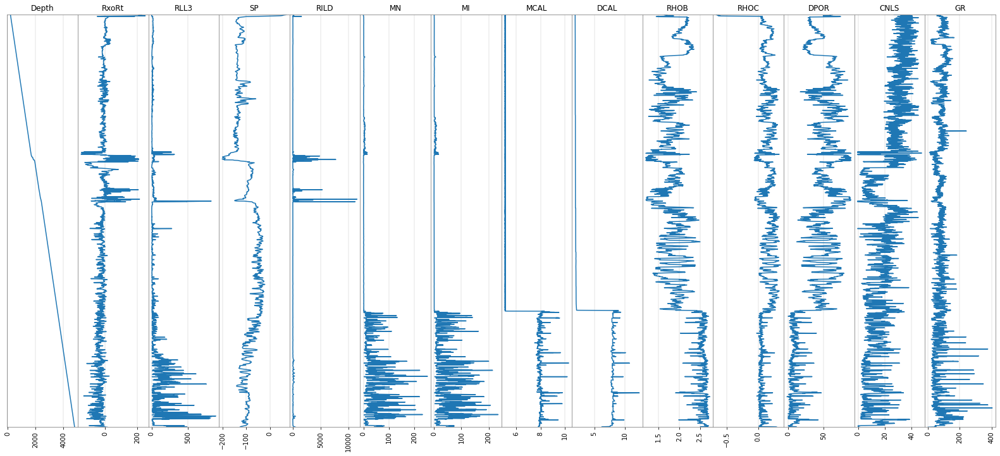

In [11]:
well.plot()

# ML models

### Clustering by DBSCAN 

In [12]:
#import necessary packages to start with the model
from sklearn.cluster import DBSCAN
import sklearn.utils
from sklearn import preprocessing

#define features for the model
DB_data = df[['GR', 'RHOB','CNLS']]
data_dim = len(DB_data.columns)
data_dim

3

In [13]:
## Finding elbow point
from sklearn.neighbors import NearestNeighbors # importing the library
neighb = NearestNeighbors(n_neighbors=2*data_dim) # creating an object of the NearestNeighbors class
nbrs=neighb.fit(DB_data) # fitting the data to the object
distances,indices=nbrs.kneighbors(DB_data)

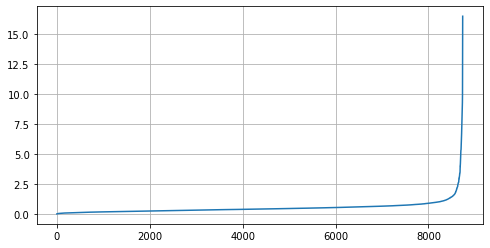

In [14]:
# Sort and plot the distances results
distances = np.sort(distances, axis = 0) # sorting the distances
distances = distances[:, 1] # taking the second column of the sorted distances
plt.rcParams['figure.figsize'] = (8,4) # setting the figure size
plt.plot(distances) # plotting the distances
plt.grid()
plt.show()

In [15]:
#from the elbow point where the maximum curvature is observed from above plot, we determine that Eps = 4
# eps = 

In [16]:
#drop NaN values in the feature data if you have True in the previous command
# DB_data = np.nan_to_num(DB_data)

#normalize the feature data
DB_data = preprocessing.StandardScaler().fit(DB_data).transform(DB_data)

#define DBSCAN model and fit the feature data
db = DBSCAN(eps=0.3, min_samples=30).fit(DB_data)

# core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
# core_samples_mask[db.core_sample_indices_] = True
#extract cluster labels and create "Clus_Db" column for df data
labels = db.labels_
df["Clus_Db"]=labels

In [17]:
df["Clus_Db"].value_counts()

 0    7523
-1    1053
 2      83
 1      80
Name: Clus_Db, dtype: int64

In [18]:
# extract set of labels and convert them into the list for the next "for loop"
clusters=list(set(df['Clus_Db']))
clusters

[0, 1, 2, -1]

100%|████████████████████████████████████████████████████████████████████████████| 8738/8738 [00:02<00:00, 3263.17it/s]


<function matplotlib.pyplot.show(close=None, block=None)>

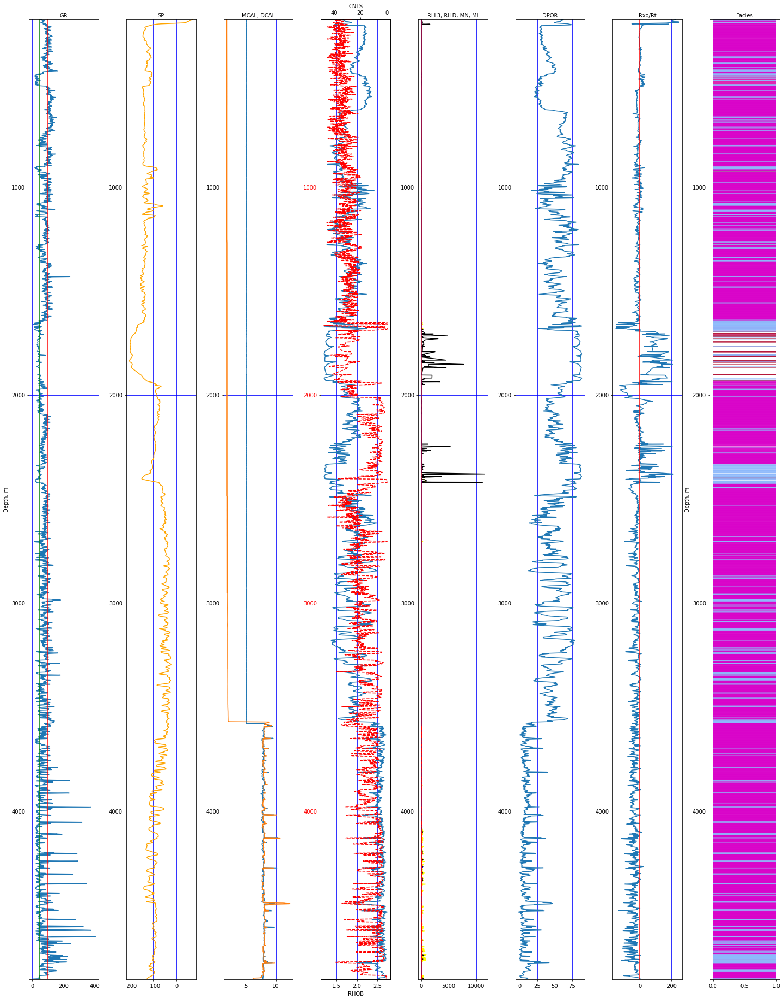

In [19]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8) = plt.subplots(1,8, figsize=(20,25))

#setting Depth limits
plt.setp((ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8), ylim=[np.min(df.Depth), np.max(df.Depth)])
fig.tight_layout()

#*plot Gamma ray log (GR)
ax1.plot(df.GR, df.Depth)
ax1.vlines(100,np.min(df.Depth), np.max(df.Depth), color='red')
ax1.vlines(50,np.min(df.Depth), np.max(df.Depth), color = 'green')
ax1.invert_yaxis()
ax1.set_xlabel("GR")
ax1.set_ylabel("Depth, m")
# ax1.set_ylim(4900,180)
ax1.xaxis.set_label_position('top') 
ax1.grid(color='b')

#*plot Spontaneous potential data log (SP)
ax2.plot(df.SP, df.Depth, color='orange')
ax2.invert_yaxis()
ax2.set_xlabel("SP")
ax2.xaxis.set_label_position('top') 
ax2.grid(color='b')

#plot normal caliper (MCAL) and differential caliper (DCAL) log showing size of the well
ax3.plot(df.MCAL, df.Depth)
ax3.plot(df.DCAL, df.Depth)
ax3.invert_yaxis()
ax3.set_xlabel("MCAL, DCAL")
ax3.xaxis.set_label_position('top') 
ax3.grid(color='b')

# #plot bulk density (RHOB) and corrected bulk density (RHOC) data log
# ax4.plot(df.RHOB, df.Depth, color='yellow')
# ax4.plot(df.RHOC, df.Depth, color='red')
# ax4.invert_yaxis()
# ax4.set_xlabel("RHOC, RHOB")
# ax4.xaxis.set_label_position('top') 
# ax4.grid(color='b')

#plot compansated neutron log (CNLS) and bulk density together (RHOB)
ax4.plot(df.RHOB, df.Depth)
ax4.tick_params(axis='y', labelcolor='red')

ax_twin = ax4.twiny()
ax_twin.plot(df.CNLS, df.Depth, color='red', linestyle='dashed')
ax_twin.tick_params(axis='y', labelcolor='green')
ax_twin.set_xlabel('CNLS')
ax_twin.xaxis.set_label_position('top')
ax_twin.invert_xaxis()

ax4.invert_yaxis()
ax4.set_xlabel("RHOB")
ax4.grid(color='b')

#plot Laterlog 3 (RLL3), deep induction resistivity (RILD), Resistivity wide array (MN), Resistivity intermediate array (MI)
ax5.plot(df.RLL3, df.Depth, color='yellow')
ax5.plot(df.RILD, df.Depth, color='black')
ax5.plot(df.MN, df.Depth, color='blue')
ax5.plot(df.MI, df.Depth, color='red')
ax5.invert_yaxis()
ax5.set_xlabel("RLL3, RILD, MN, MI")
ax5.xaxis.set_label_position('top') 
ax5.grid(color='b')

#plot density porosity log (DPOR)
ax6.plot(df.DPOR, df.Depth)
ax6.invert_yaxis()
ax6.set_xlabel("DPOR")
ax6.xaxis.set_label_position('top') 
ax6.grid(color='b')

#plot Ratio of Shallow and deep resistivity log data (Rxo/Rt)
ax7.plot(df.RxoRt, df.Depth)
ax7.vlines(0,np.min(df.Depth), np.max(df.Depth), color = 'red')
ax7.invert_yaxis()
ax7.set_xlabel("Rxo/Rt")
ax7.xaxis.set_label_position('top')
ax7.grid(color='b')


ax8.set_xlabel('Facies')
ax8.set_ylabel('Depth, m')
ax8.xaxis.set_label_position('top')
ax8.invert_yaxis()
n = len(df)

#this for loop checks clustering labels, if neighboring labels are the same in the date it draws a line with the determined
#color

#an alternative implementation can be applied because this one fails if the data contains missing data at certain elevations
#in order to understand this failure check white lines in the facies log
for j in clusters:
    #define random RGB color for each cluster:
    color = np.random.random((len(clusters),4))
    for i in tqdm(range(0,n-1)):
        if (df.Clus_Db[i+1]==df.Clus_Db[i] & df.Clus_Db[i]==j):
            ax8.hlines(y = df.Depth[i], color=color, xmin = 0, xmax = 1)
        else:
            pass

plt.show
#plt.savefig('log-DB-100.png', dpi = 100, bbox_inches='tight', facecolor = 'white')

### Clustering by K means

In [20]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans 

Km_data = df[['GR', 'RHOB','CNLS']]
Km_data = np.nan_to_num(Km_data)
Km_data = StandardScaler().fit_transform(Km_data)

100%|██████████████████████████████████████████████████████████████████████████████████| 19/19 [00:20<00:00,  1.06s/it]


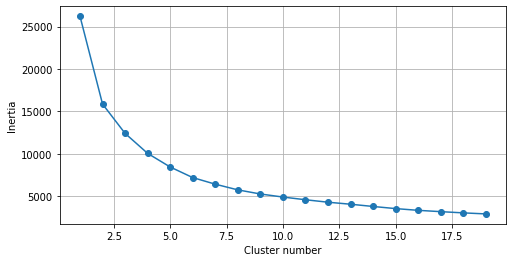

In [21]:
#this function is used in order to visualize elbow point (#of clusters) for K means clustering

def opt_km(data, max_it):
    means = []
    inertias = []
    
    for k in tqdm(range(1, max_it)):
        kmeans = KMeans(n_clusters = k)
        kmeans.fit(data)
        means.append(k)
        inertias.append(kmeans.inertia_)
        
    #elbow point graph
    fig.subplots()
    plt.plot(means, inertias, 'o-')
    plt.xlabel('Cluster number')
    plt.ylabel('Inertia')
    plt.grid(True)
    plt.show
    
opt_km(Km_data, 20)

we can notice that so called elbow point is observed at Cluster number = 3.0 . That is why we are gonna choose 3 for cluster number for the model

In [22]:
clusterNum = 3
k_means = KMeans(init = "k-means++", n_clusters = clusterNum, n_init = 20)
k_means.fit(Km_data)

KMeans(n_clusters=3, n_init=20)

In [23]:
k_means_cluster_centers = k_means.cluster_centers_

In [24]:
df["Clus_km"] = k_means.labels_
clusters = list(set(df["Clus_km"]))
clusters

[0, 1, 2]

In [25]:
Km_frame = pd.DataFrame(Km_data)

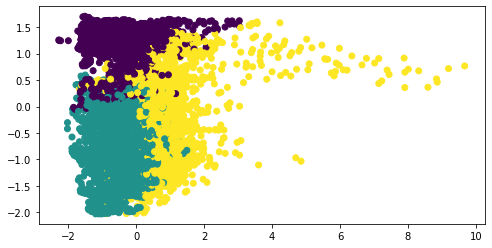

In [26]:
#just for visualizing the results
#'GR', 'RHOB','CNLS'
plt.scatter (x = Km_frame[0], y = Km_frame[1], c = df.Clus_km)

100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:18<00:00,  6.26s/it]


<function matplotlib.pyplot.show(close=None, block=None)>

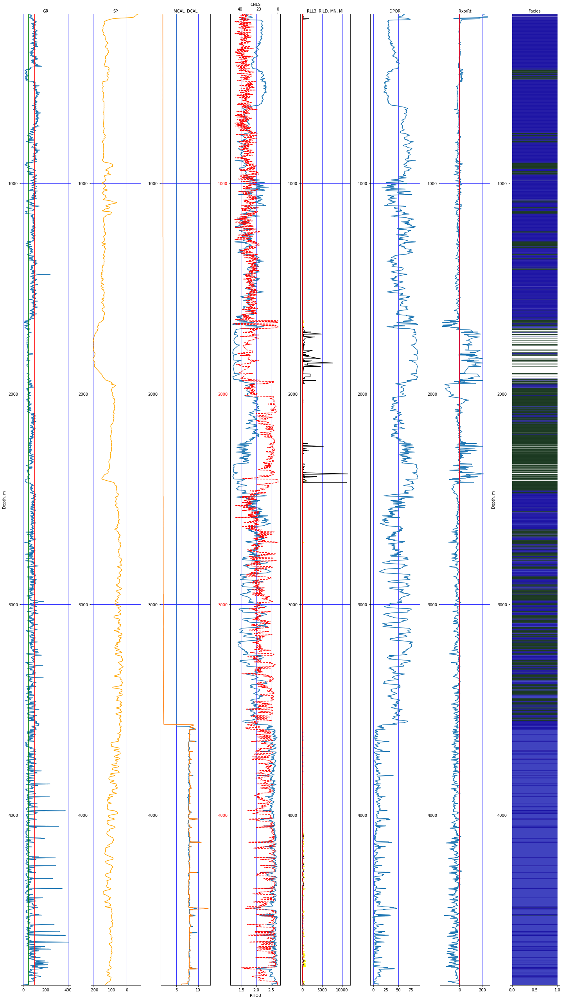

In [27]:
# [['GR', 'SP', 'DPOR', 'RHOC','CNLS','RILD']]

fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8) = plt.subplots(1,8, figsize=(20,35))

#setting Depth limits
plt.setp((ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8), ylim=[np.min(df.Depth), np.max(df.Depth)])
fig.tight_layout()

#*plot Gamma ray log (GR)
ax1.plot(df.GR, df.Depth)
ax1.vlines(100,np.min(df.Depth), np.max(df.Depth), color='red')
ax1.vlines(50,np.min(df.Depth), np.max(df.Depth), color = 'green')
ax1.invert_yaxis()
ax1.set_xlabel("GR")
ax1.set_ylabel("Depth, m")
# ax1.set_ylim(4900,180)
ax1.xaxis.set_label_position('top') 
ax1.grid(color='b')

#*plot Spontaneous potential data log (SP)
ax2.plot(df.SP, df.Depth, color='orange')
ax2.invert_yaxis()
ax2.set_xlabel("SP")
ax2.xaxis.set_label_position('top') 
ax2.grid(color='b')

#plot normal caliper (MCAL) and differential caliper (DCAL) log showing size of the well
ax3.plot(df.MCAL, df.Depth)
ax3.plot(df.DCAL, df.Depth)
ax3.invert_yaxis()
ax3.set_xlabel("MCAL, DCAL")
ax3.xaxis.set_label_position('top') 
ax3.grid(color='b')

# #plot bulk density (RHOB) and corrected bulk density (RHOC) data log
# ax4.plot(df.RHOB, df.Depth, color='yellow')
# ax4.plot(df.RHOC, df.Depth, color='red')
# ax4.invert_yaxis()
# ax4.set_xlabel("RHOC, RHOB")
# ax4.xaxis.set_label_position('top') 
# ax4.grid(color='b')

#plot compansated neutron log (CNLS) and bulk density together (RHOB)
ax4.plot(df.RHOB, df.Depth)
ax4.tick_params(axis='y', labelcolor='red')

ax_twin = ax4.twiny()
ax_twin.plot(df.CNLS, df.Depth, color='red', linestyle='dashed')
ax_twin.tick_params(axis='y', labelcolor='green')
ax_twin.set_xlabel('CNLS')
ax_twin.xaxis.set_label_position('top')
ax_twin.invert_xaxis()

ax4.invert_yaxis()
ax4.set_xlabel("RHOB")
ax4.grid(color='b')

#plot Laterlog 3 (RLL3), deep induction resistivity (RILD), Resistivity wide array (MN), Resistivity intermediate array (MI)
ax5.plot(df.RLL3, df.Depth, color='yellow')
ax5.plot(df.RILD, df.Depth, color='black')
ax5.plot(df.MN, df.Depth, color='blue')
ax5.plot(df.MI, df.Depth, color='red')
ax5.invert_yaxis()
ax5.set_xlabel("RLL3, RILD, MN, MI")
ax5.xaxis.set_label_position('top') 
ax5.grid(color='b')

#plot density porosity log (DPOR)
ax6.plot(df.DPOR, df.Depth)
ax6.invert_yaxis()
ax6.set_xlabel("DPOR")
ax6.xaxis.set_label_position('top') 
ax6.grid(color='b')


#plot Ratio of Shallow and deep resistivity log data (Rxo/Rt)
ax7.plot(df.RxoRt, df.Depth)
ax7.vlines(0,np.min(df.Depth), np.max(df.Depth), color = 'red')
ax7.invert_yaxis()
ax7.set_xlabel("Rxo/Rt")
ax7.xaxis.set_label_position('top')
ax7.grid(color='b')


ax8.set_xlabel('Facies')
ax8.set_ylabel('Depth, m')
ax8.xaxis.set_label_position('top')
ax8.invert_yaxis()
n = len(df)

for j in tqdm(clusters):
    #define random RGB color for each cluster:
    color = np.random.random((len(clusters),4))
    for i in range(0,n-1):
        if (df.Clus_km[i+1]==df.Clus_km[i] & df.Clus_km[i]==j):
            ax8.hlines(y = df.Depth[i], color=color, xmin = 0, xmax = 1)
        else:
            pass

plt.show
#plt.savefig('log-Kmeans-100.png', dpi = 100, bbox_inches='tight', facecolor = 'white')

### Hierarchical clustering

##  !!!  I recommend not to run this model, because it takes too much computational time

In [28]:
from sklearn.preprocessing import StandardScaler
HC_data = df[['GR', 'RHOB','CNLS']]
HC_data = np.nan_to_num(HC_data)
HC_data = StandardScaler().fit_transform(HC_data)

In [29]:
from sklearn.metrics.pairwise import euclidean_distances
dist_matrix = euclidean_distances(HC_data,HC_data) 
print(dist_matrix)

[[0.         0.34668027 0.34305845 ... 3.75294451 3.76427157 3.72061416]
 [0.34668027 0.         0.10909013 ... 3.49613594 3.50748691 3.46669524]
 [0.34305845 0.10909013 0.         ... 3.54794717 3.55796907 3.51626543]
 ...
 [3.75294451 3.49613594 3.54794717 ... 0.         0.05103074 0.10809018]
 [3.76427157 3.50748691 3.55796907 ... 0.05103074 0.         0.07520558]
 [3.72061416 3.46669524 3.51626543 ... 0.10809018 0.07520558 0.        ]]


In [30]:
import scipy.cluster.hierarchy
from scipy.cluster.hierarchy import fcluster
from scipy.cluster import hierarchy 

Z_using_dist_matrix = hierarchy.linkage(dist_matrix, 'complete')

C:\Users\pasha\AppData\Local\Temp\ipykernel_12420\4236488318.py:5: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z_using_dist_matrix = hierarchy.linkage(dist_matrix, 'complete')


In [31]:
from sklearn.cluster import AgglomerativeClustering 
clusterNum = 3
agglom = AgglomerativeClustering(n_clusters = clusterNum, linkage = 'complete')
agglom.fit(dist_matrix)

clusters = list(set(agglom.labels_))

C:\Users\pasha\python\envs\New\lib\site-packages\sklearn\cluster\_agglomerative.py:492: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  out = hierarchy.linkage(X, method=linkage, metric=affinity)


In [32]:
df['HC_cluster'] = agglom.labels_
clusters = set(agglom.labels_)
df.head()

,Depth,RxoRt,RLL3,SP,RILD,MN,MI,MCAL,DCAL,RHOB,RHOC,DPOR,CNLS,GR,Clus_Db,Clus_km,HC_cluster
0,195.0,226.0848,0.4076,69.8953,132.5052,-0.3548,0.1863,5.1090,1.8878,1.6973,-0.6303,59.2216,30.0657,60.4576,0,1,1
1,195.5,223.5031,0.4063,69.2303,123.6225,-0.3619,0.1867,5.1031,1.8882,1.6791,-0.6409,60.2877,26.7625,54.1495,0,1,1
2,196.0,221.4560,0.4047,68.4478,116.9258,-0.3668,0.1860,5.0872,1.8878,1.6585,-0.6539,61.4914,27.6017,51.9944,0,1,1
3,196.5,219.8248,0.4033,67.4843,111.7925,-0.3613,0.1867,5.0881,1.8884,1.6435,-0.6649,62.3711,31.5870,52.9645,0,1,1
4,197.0,218.1438,0.4023,66.3013,106.7821,-0.3569,0.1870,5.0972,1.8883,1.6390,-0.6705,62.6343,35.8251,54.9659,-1,2,1


100%|███████████████████████████████████████████████████████████████████████████| 8738/8738 [00:00<00:00, 12555.05it/s]


<function matplotlib.pyplot.show(close=None, block=None)>

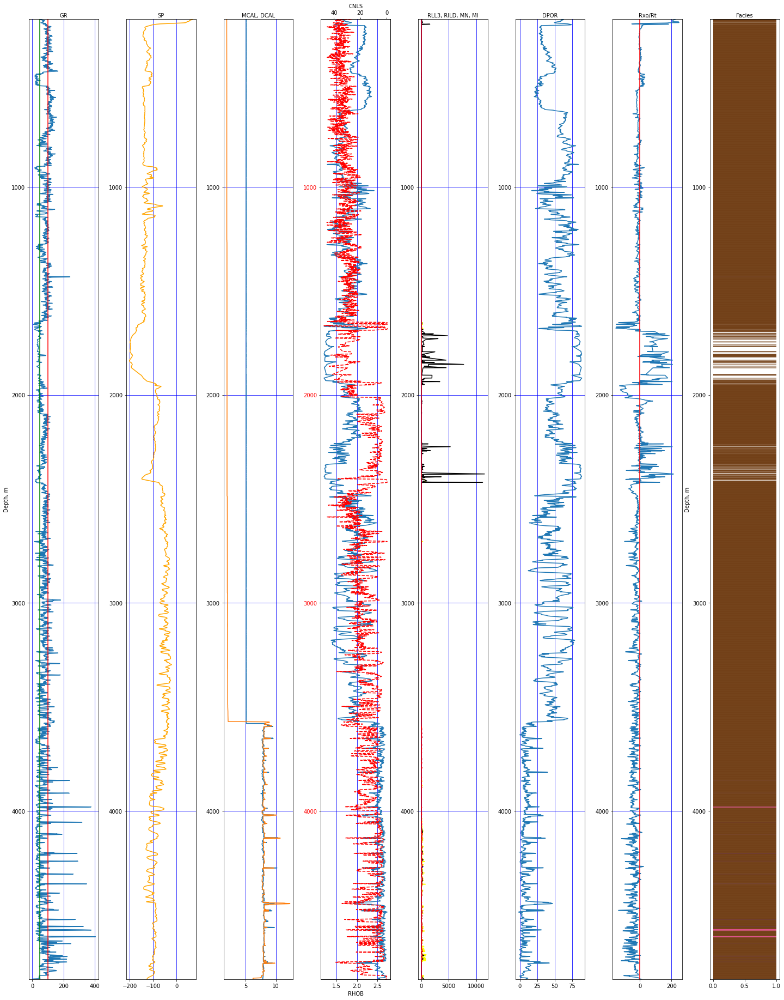

In [33]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8) = plt.subplots(1,8, figsize=(20,25))

#setting Depth limits
plt.setp((ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8), ylim=[np.min(df.Depth), np.max(df.Depth)])
fig.tight_layout()

#*plot Gamma ray log (GR)
ax1.plot(df.GR, df.Depth)
ax1.vlines(100,np.min(df.Depth), np.max(df.Depth), color='red')
ax1.vlines(50,np.min(df.Depth), np.max(df.Depth), color = 'green')
ax1.invert_yaxis()
ax1.set_xlabel("GR")
ax1.set_ylabel("Depth, m")
# ax1.set_ylim(4900,180)
ax1.xaxis.set_label_position('top') 
ax1.grid(color='b')

#*plot Spontaneous potential data log (SP)
ax2.plot(df.SP, df.Depth, color='orange')
ax2.invert_yaxis()
ax2.set_xlabel("SP")
ax2.xaxis.set_label_position('top') 
ax2.grid(color='b')

#plot normal caliper (MCAL) and differential caliper (DCAL) log showing size of the well
ax3.plot(df.MCAL, df.Depth)
ax3.plot(df.DCAL, df.Depth)
ax3.invert_yaxis()
ax3.set_xlabel("MCAL, DCAL")
ax3.xaxis.set_label_position('top') 
ax3.grid(color='b')

# #plot bulk density (RHOB) and corrected bulk density (RHOC) data log
# ax4.plot(df.RHOB, df.Depth, color='yellow')
# ax4.plot(df.RHOC, df.Depth, color='red')
# ax4.invert_yaxis()
# ax4.set_xlabel("RHOC, RHOB")
# ax4.xaxis.set_label_position('top') 
# ax4.grid(color='b')

#plot compansated neutron log (CNLS) and bulk density together (RHOB)
ax4.plot(df.RHOB, df.Depth)
ax4.tick_params(axis='y', labelcolor='red')

ax_twin = ax4.twiny()
ax_twin.plot(df.CNLS, df.Depth, color='red', linestyle='dashed')
ax_twin.tick_params(axis='y', labelcolor='green')
ax_twin.set_xlabel('CNLS')
ax_twin.xaxis.set_label_position('top')
ax_twin.invert_xaxis()

ax4.invert_yaxis()
ax4.set_xlabel("RHOB")
ax4.grid(color='b')

#plot Laterlog 3 (RLL3), deep induction resistivity (RILD), Resistivity wide array (MN), Resistivity intermediate array (MI)
ax5.plot(df.RLL3, df.Depth, color='yellow')
ax5.plot(df.RILD, df.Depth, color='black')
ax5.plot(df.MN, df.Depth, color='blue')
ax5.plot(df.MI, df.Depth, color='red')
ax5.invert_yaxis()
ax5.set_xlabel("RLL3, RILD, MN, MI")
ax5.xaxis.set_label_position('top') 
ax5.grid(color='b')

#plot density porosity log (DPOR)
ax6.plot(df.DPOR, df.Depth)
ax6.invert_yaxis()
ax6.set_xlabel("DPOR")
ax6.xaxis.set_label_position('top') 
ax6.grid(color='b')

#plot Ratio of Shallow and deep resistivity log data (Rxo/Rt)
ax7.plot(df.RxoRt, df.Depth)
ax7.vlines(0,np.min(df.Depth), np.max(df.Depth), color = 'red')
ax7.invert_yaxis()
ax7.set_xlabel("Rxo/Rt")
ax7.xaxis.set_label_position('top')
ax7.grid(color='b')


ax8.set_xlabel('Facies')
ax8.set_ylabel('Depth, m')
ax8.xaxis.set_label_position('top')
ax8.invert_yaxis()
n = len(df)

for j in clusters:
    #define random RGB color for each cluster:
    color = np.random.random((len(clusters),4))
    for i in tqdm(range(0,n-1)):
        if (df.HC_cluster[i+1]==df.HC_cluster[i] & df.HC_cluster[i]==j):
            ax8.hlines(y = df.Depth[i], color=color, xmin = 0, xmax = 1)
        else:
            pass

plt.show
#plt.savefig('log-HC-100.png', dpi = 100, bbox_inches='tight', facecolor = 'white')

### Visualize Facies column generated from K-means model with welly

<AxesSubplot:>

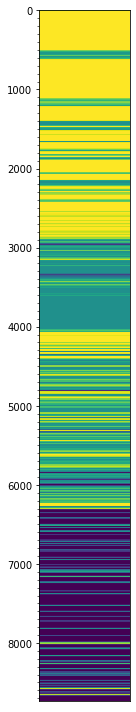

In [37]:
#the problem with facies log implementation that was mentioned before can be eliminated with welly 2d visualization
#however this implementation needs to be integrated with matplotlib well log plots 

well = Well.from_df(df)
well.data['Clus_km'].plot_2d(cmap = 'viridis')
# db = well.data['Clus_Db'].plot_2d(cmap = 'viridis')

### Data visualization with Plotly

In [38]:
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

In [39]:
fig = make_subplots( rows=1, cols = 8, shared_yaxes=True)
fig.add_trace(go.Scatter(x=df['GR'], y=df['Depth']), row=1, col=1)
fig.update_xaxes(title_text='GR', row=1, col=1)

fig.add_trace(go.Scatter(x=df['SP'], y=df['Depth']), row=1, col=2)
fig.update_xaxes(title_text='SP', row=1, col=2)

fig.add_trace(go.Scatter(x=df['MCAL'], y=df['Depth']), row=1, col=3)
fig.add_trace(go.Scatter(x=df['DCAL'], y=df['Depth']), row=1, col=3)
fig.update_xaxes(title_text='MCAL, DCAL', row=1, col=3)

fig.add_trace(go.Scatter(x=df['CNLS'], y=df['Depth']), row=1, col=4)
fig.update_xaxes(title_text='CNLS', row=1, col=4)

fig.add_trace(go.Scatter(x=df['RHOB'], y=df['Depth']), row=1, col=5)
fig.update_xaxes(title_text='RHOB', row=1, col=5)

fig.add_trace(go.Scatter(x=df['RLL3'], y=df['Depth']), row=1, col=6)
fig.add_trace(go.Scatter(x=df['RILD'], y=df['Depth']), row=1, col=6)
fig.add_trace(go.Scatter(x=df['MN'], y=df['Depth']), row=1, col=6)
fig.add_trace(go.Scatter(x=df['MI'], y=df['Depth']), row=1, col=6)
fig.update_xaxes(title_text='RLL3, RILD, MN, MI', row=1, col=6)

fig.add_trace(go.Scatter(x=df['DPOR'], y=df['Depth']), row=1, col=7)
fig.update_xaxes(title_text='DPOR', row=1, col=7)

fig.add_trace(go.Scatter(x=df['RxoRt'], y=df['Depth']), row=1, col=8)
fig.update_xaxes(title_text='RxoRt', row=1, col=8)


fig.update_yaxes(title_text='DEPTH', row=1, col=1, autorange='reversed')

fig.update_layout(title_text='Log Plot',  height=1500)


fig.show()

### Superpose facies logs from all models 

100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:37<00:00, 12.58s/it]


<function matplotlib.pyplot.show(close=None, block=None)>

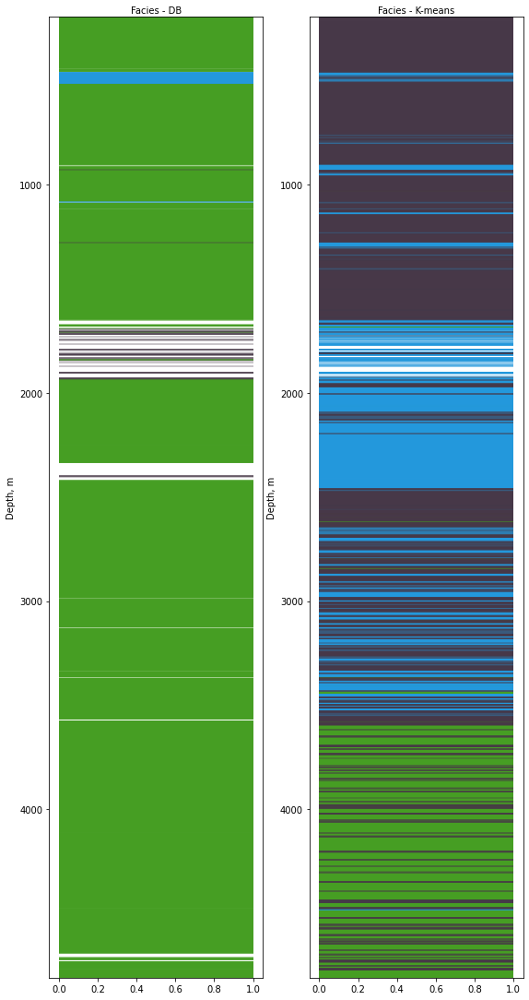

In [40]:
#add ax3 and change subplot amount if HC cluster visualization is also going to be used
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(8,15))

#setting Depth limits
plt.setp((ax1, ax2, ax3), ylim=[np.min(df.Depth), np.max(df.Depth)])
fig.tight_layout()

# Db Clustering
ax1.set_xlabel('Facies - DB')
ax1.set_ylabel('Depth, m')
ax1.xaxis.set_label_position('top')
ax1.invert_yaxis()
n = len(df)

ax2.set_xlabel('Facies - K-means')
ax2.set_ylabel('Depth, m')
ax2.xaxis.set_label_position('top')
ax2.invert_yaxis()

ax3.set_xlabel('Facies - HC')
ax3.set_ylabel('Depth, m')
ax3.xaxis.set_label_position('top')
ax3.invert_yaxis()

# in order to have same random color labels for facies below main loop is needed
for j in tqdm(clusters):
    #define random RGB color for each cluster:
    color = np.random.random((len(clusters),4))
    for i in range(0,n-1):
        if (df.Clus_Db[i+1]==df.Clus_Db[i] & df.Clus_Db[i]==j):
            ax1.hlines(y = df.Depth[i], color=color, xmin = 0, xmax = 1)
        else:
            pass
    for i in range(0,n-1):
        if (df.Clus_km[i+1]==df.Clus_km[i] & df.Clus_km[i]==j):
            ax2.hlines(y = df.Depth[i], color=color, xmin = 0, xmax = 1)
        else:
            pass
# put the loop below under "#" if HC clustering model is not used        
#     for i in range(0,n-1):
#         if (df.HC_cluster[i+1]==df.HC_cluster[i] & df.HC_cluster[i]==j):
#             ax3.hlines(y = df.Depth[i], color=color, xmin = 0, xmax = 1)
#         else:
#             pass

plt.show

# References

the code uses public data of Kansas Geological Survey. Retrieved from: https://www.kaggle.com/datasets/a6f2db5c55b8f54699209a99a46dc5467c9d4c7649ed8bcae6c14789765f78d4?resource=download

Unfortunately, the data is an unsupervised data. Thus, accuracy of the models can not be measured. This code is compiled just for curiosity by Pasha Bayramli